In [ ]:
# this part uses the Wikitext-2 dataset. To access torchtext datasets, please install `torchdata`:
# `pip install torchdata` ir `conda install -c pytorch torchdata` in activated environment
# or `!pip install torchdata` on colab.
!pip install torchdata
# notes:
# torch=2.0.0 <-> torchtext 0.15.1
# torch=1.13.0 <-> torchtext 0.14.0
# torch=1.12.1 <-> torchtext 0.13.1
# downgrading torchtext example: !pip install torchtext==0.13.1 --no-deps
# torchtext requires the `portalocker` package to download datasets:
!pip install portalocker

# imports for the practice (you can add more if you need)
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import math
from typing import Tuple

# pytorch
import torch
from torch import nn, Tensor
import torch.nn.functional as F
from torch.nn import TransformerEncoder, TransformerEncoderLayer
from torch.utils.data import dataset

# torchtext
import torchtext
from torchtext.datasets import WikiText2
from torchtext.data.utils import get_tokenizer
from torchtext.vocab import build_vocab_from_iterator

seed = 211
np.random.seed(seed)
torch.manual_seed(seed)

  Using cached torchdata-0.8.0-cp310-cp310-manylinux1_x86_64.whl.metadata (5.4 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
Using cached torchdata-0.8.0-cp310-cp310-manylinux1_x86_64.whl (2.7 MB)
Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)


/usr/local/lib/python3.10/dist-packages/torchtext/datasets/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released version will be 0.18 (this one). You can silence this warning by calling the following at the beginnign of your scripts: `import torchtext; torchtext.disable_torchtext_deprecation_warning()`
  warnings.warn(torchtext._TORCHTEXT_DEPRECATION_MSG)
/usr/local/lib/python3.10/dist-packages/torchtext/data/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released version will be 0.18 (this one). You can silence this warning by calling the following at the beginnign of your scripts: `import torchtext; torchtext.disable_torchtext_deprecation_warning()`
  warnings.warn(torchtext._TORCHTEXT_DEPRECATION_MSG)
/usr/local/lib/python3.10/dist-packages/torchtext/vocab/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext i

In [ ]:
print(f'pytorch: {torch.__version__}, torchtext: {torchtext.__version__}')

pytorch: 2.3.1+cu121, torchtext: 0.18.0+cpu


In [ ]:
!pip install kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d subhajournal/phishingemails

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory
Dataset URL: https://www.kaggle.com/datasets/subhajournal/phishingemails
License(s): GNU Lesser General Public License 3.0
 94% 17.0M/18.0M [00:00<00:00, 47.7MB/s]
100% 18.0M/18.0M [00:00<00:00, 44.2MB/s]


In [ ]:
do_unzip = True
if do_unzip:
    !unzip /content/phishingemails.zip

Archive:  /content/phishingemails.zip
  inflating: Phishing_Email.csv      


In [ ]:
import pandas as pd

df = pd.read_csv("Phishing_Email.csv")

# df.head()

df = df.drop(columns=['Unnamed: 0'])

df.isnull().sum()

df.dropna(inplace=True,axis=0)
df.drop_duplicates(inplace=True)

print("Dimension of the row data:",df.shape)
max_len = df["Email Text"].apply(len).max()
max_len_index = df["Email Text"].apply(len).idxmax()

print(f"max_len: {max_len}")
# print(df["Email Text"][max_len_index])
print(f"max_len_index: {max_len_index}")

print(df['Email Type'].value_counts())


Dimension of the row data: (17538, 2)
max_len: 17036692
max_len_index: 12500
Email Type
Safe Email        10980
Phishing Email     6558
Name: count, dtype: int64


,count
Email Type,
Safe Email,10980
Phishing Email,6558


['Safe Email', 'Phishing Email']

['re : 6 . 1100 , disc : uniformitarianism , re : 1086 ; sex / lang dick hudson \'s observations on us use of \'s on \' but not \'d aughter \' as a vocative are very thought-provoking , but i am not sure that it is fair to attribute this to " sons " being " treated like senior relatives " . for one thing , we do n\'t normally use \' brother \' in this way any more than we do \'d aughter \' , and it is hard to imagine a natural class comprising senior relatives and \'s on \' but excluding \' brother \' . for another , there seem to me to be differences here . if i am not imagining a distinction that is not there , it seems to me that the senior relative terms are used in a wider variety of contexts , e . g . , calling out from a distance to get someone \'s attention , and hence at the beginning of an utterance , whereas \'s on \' seems more natural in utterances like \' yes , son \' , \' hand me that , son \' than in ones like \' son ! \' or \' son , help me ! \' ( although perhaps thes

In [ ]:
# Convert categorical labels to binary (0 and 1)
#safe emails will be replaced by 1 and phishing emails by 0
df['Email Type'] = df['Email Type'].apply(lambda x: 1 if x == 'Safe Email' else 0)

# Separate the dataset into two categories
df_class_0 = df[df['Email Type'] == 0]
df_class_1 = df[df['Email Type'] == 1]

# Find the minimum size between the two categories
min_size = min(len(df_class_0), len(df_class_1))

# Sample equal amounts from each category
df_class_0_sampled = df_class_0.sample(n=min_size, random_state=42)
df_class_1_sampled = df_class_1.sample(n=min_size, random_state=42)

# Combine the sampled data
df_balanced = pd.concat([df_class_0_sampled, df_class_1_sampled])

# Shuffle the dataset to ensure mixing of categories
df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)

print(df_balanced['Email Type'].value_counts())



Email Type
1    6558
0    6558
Name: count, dtype: int64


In [ ]:
import re

def clean_email(email):
    # Remove URLs
    email = re.sub(r'http\S+|www.\S+', '', email)

    # Remove special characters but keep letters, numbers, and spaces
    email = re.sub(r'[^a-zA-Z0-9\s]', '', email)

    # Remove words longer than 20 characters
    email = ' '.join(word for word in email.split() if len(word) <= 20)

    return email


# Example usage
email = "Hello, this is a sample email! Please visit https://example.com for more info. Thanks :)"
cleaned_email = clean_email(email)
print(cleaned_email)

Hello this is a sample email Please visit for more info Thanks


In [ ]:
df_balanced['Email Text'] = df_balanced['Email Text'].apply(clean_email)
max_len = df_balanced["Email Text"].apply(len).max()
max_len_index = df_balanced["Email Text"].apply(len).idxmax()

print(f"max_len: {max_len}")
print(df_balanced["Email Text"][max_len_index])
print(f"max_len_index: {max_len_index}")
df_balanced.isnull().sum()

max_len: 112907
enron mentions enron discusses credit line of 1 billion to 2 billion with banks the wall street journal 10 29 01 manager s journal how enron ran out of gas the wall street journal 10 29 01 enron seeks additional financing the new york times 10 29 01 global investing enron stock plunge deals a heavy blow to mutual funds financial times oct 29 2001 comment analysis enron flickers financial times 10 29 01 front page companies reportedly for 1 2 bln usd afx ap 10 29 01 enron said seeking new credit lines american banker 10 29 01 usa enron in talks for 1 2 bln credit line wsj reuters english news service 10 29 01 japan japan s teijin enron study coal fired power plant reuters english news service 10 29 01 enron teijin to build power plant in japan report says bloomberg 10 29 01 once mighty enron strains under scrutiny the new york times 10 28 01 plumbing mystery of deals by enron the new york times 10 28 01 investors seem to ignore discouraging news the new york times 10 28 

,0
Email Text,0
Email Type,0


In [ ]:

label_counts = pd.DataFrame(df_balanced['Email Type'].value_counts())
#df_balanced.head()
label_counts
label_values = list(label_counts.index)
order = list(pd.DataFrame(df_balanced['Email Type'].value_counts()).index)
label_values = [l for _,l in sorted(zip(order, label_values))]

texts = df_balanced['Email Text'].values
labels = df_balanced['Email Type'].values
text_lengths = [len(texts[i].split()) for i in range(len(texts))]
# print(texts)
# print(labels)
np.average(list(len(email) for email in df_balanced['Email Text'].tolist()))


1598.2407746264105

In [ ]:
print(sum([1 for i in range(len(text_lengths)) if text_lengths[i] >= 300]))
print(sum([1 for i in range(len(text_lengths)) if text_lengths[i] <= 300]))

3076
10048


In [ ]:
from transformers import DistilBertTokenizer
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased', do_lower_case=True)

print('Original Text: ', texts[0], '\n')
print('Tokenized Text: ', tokenizer.tokenize(texts[0]), '\n')
print('Token IDs: ', tokenizer.convert_tokens_to_ids(tokenizer.tokenize(texts[0])))

<class 'method'>
Original Text:  recruiting i received this email some time ago and may not have forward it to you i apologize for any oversight on my part i ll also forward the email that i sent as a response this coupled with the information from sally gould should get the comp fin interview process started kevin k forwarded by kevin kindall corp enron on 11 20 2000 04 44 pm jean eisel on 11 06 2000 03 34 05 pm to kevin kindall enron com cc sgould andrew cmu edu subject re recruiting hi kevin wow you sure do pack one e mail i will try to answer questions after each of you look in the email for answers on monday november 06 2000 2 39 pm 0600 kevin kindall enron com wrote hello it was a pleasure to come back to cmu and i enjoyed interacting with the students vince k has expressed interest in interviewing the computational finance students enron will conduct first round interviews with the mba students in december and would like to set up seperate interviews for the comp fin students en

In [ ]:
text_ids = [tokenizer.encode(text, max_length=300, pad_to_max_length=True) for text in texts]
text_ids[0]

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


[101,
 14357,
 1045,
 2363,
 2023,
 10373,
 2070,
 2051,
 3283,
 1998,
 2089,
 2025,
 2031,
 2830,
 2009,
 2000,
 2017,
 1045,
 12134,
 2005,
 2151,
 15709,
 2006,
 2026,
 2112,
 1045,
 2222,
 2036,
 2830,
 1996,
 10373,
 2008,
 1045,
 2741,
 2004,
 1037,
 3433,
 2023,
 11211,
 2007,
 1996,
 2592,
 2013,
 8836,
 14913,
 2323,
 2131,
 1996,
 4012,
 2361,
 10346,
 4357,
 2832,
 2318,
 4901,
 1047,
 2830,
 2098,
 2011,
 4901,
 17704,
 3363,
 13058,
 4372,
 4948,
 2006,
 2340,
 2322,
 2456,
 5840,
 4008,
 7610,
 3744,
 1041,
 5562,
 2140,
 2006,
 2340,
 5757,
 2456,
 6021,
 4090,
 5709,
 7610,
 2000,
 4901,
 17704,
 3363,
 4372,
 4948,
 4012,
 10507,
 22214,
 7140,
 6392,
 4080,
 4642,
 2226,
 3968,
 2226,
 3395,
 2128,
 14357,
 7632,
 4901,
 10166,
 2017,
 2469,
 2079,
 5308,
 2028,
 1041,
 5653,
 1045,
 2097,
 3046,
 2000,
 3437,
 3980,
 2044,
 2169,
 1997,
 2017,
 2298,
 1999,
 1996,
 10373,
 2005,
 6998,
 2006,
 6928,
 2281,
 5757,
 2456,
 1016,
 4464,
 7610,
 5757,
 8889,
 4901,
 1770

In [ ]:
text_ids_lengths = [len(text_ids[i]) for i in range(len(text_ids))]
print(min(text_ids_lengths))
print(max(text_ids_lengths))

300
300


In [ ]:
att_masks = []
for ids in text_ids:
    masks = [int(id > 0) for id in ids]
    att_masks.append(masks)

att_masks[0]

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [ ]:
from sklearn.model_selection import train_test_split

train_x, test_val_x, train_y, test_val_y = train_test_split(text_ids, labels, random_state=111, test_size=0.2)
train_m, test_val_m = train_test_split(att_masks, random_state=111, test_size=0.2)

test_x, val_x, test_y, val_y = train_test_split(test_val_x, test_val_y, random_state=111, test_size=0.5)
test_m, val_m = train_test_split(test_val_m, random_state=111, test_size=0.5)

In [ ]:
import torch

train_x = torch.tensor(train_x)
test_x = torch.tensor(test_x)
val_x = torch.tensor(val_x)
train_y = torch.tensor(train_y)
test_y = torch.tensor(test_y)
val_y = torch.tensor(val_y)
train_m = torch.tensor(train_m)
test_m = torch.tensor(test_m)
val_m = torch.tensor(val_m)

print(train_x.shape)
print(test_x.shape)
print(val_x.shape)
print(train_y.shape)
print(test_y.shape)
print(val_y.shape)
print(train_m.shape)
print(test_m.shape)
print(val_m.shape)


torch.Size([10492, 300])
torch.Size([1312, 300])
torch.Size([1312, 300])
torch.Size([10492])
torch.Size([1312])
torch.Size([1312])
torch.Size([10492, 300])
torch.Size([1312, 300])
torch.Size([1312, 300])


In [ ]:
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler

batch_size = 32

train_data = TensorDataset(train_x, train_m, train_y)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

val_data = TensorDataset(val_x, val_m, val_y)
val_sampler = SequentialSampler(val_data)
val_dataloader = DataLoader(val_data, sampler=val_sampler, batch_size=batch_size)


In [ ]:
from transformers import DistilBertForSequenceClassification, AdamW, DistilBertConfig

num_labels = len(set(labels))

model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=num_labels, output_attentions=True, output_hidden_states=False)


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
!pip install bertviz
!pip install jupyterlab
!pip install ipywidgets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.1/139.1 kB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 63.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 7.0 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 95.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 33.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.7/59.7 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.9/105.9 kB 11.1 

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

model = model.to(device)

cuda


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print('Number of trainable parameters:', count_parameters(model), '\n', model)

Number of trainable parameters: 66955010 
 DistilBertForSequenceClassification(
  (distilbert): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
           

In [ ]:
learning_rate = 1e-5
adam_epsilon = 1e-8

no_decay = ['bias', 'LayerNorm.weight']
optimizer_grouped_parameters = [
    {'params': [p for n, p in model.named_parameters() if not any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.2},
    {'params': [p for n, p in model.named_parameters() if any(nd in n for nd in no_decay)],
     'weight_decay_rate': 0.0}
]

optimizer = AdamW(optimizer_grouped_parameters, lr=learning_rate, eps=adam_epsilon)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [ ]:
from transformers import get_linear_schedule_with_warmup

num_epochs = 4
total_steps = len(train_dataloader) * num_epochs

scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)


In [ ]:
import time

def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs


In [ ]:
import numpy as np
import random

seed_val = 111

random.seed(seed_val)
np.random.seed(seed_val)
torch.manual_seed(seed_val)
torch.cuda.manual_seed_all(seed_val)

In [ ]:
train_losses = []
val_losses = []
num_mb_train = len(train_dataloader)
num_mb_val = len(val_dataloader)

if num_mb_val == 0:
    num_mb_val = 1

for n in range(num_epochs):
    train_loss = 0
    val_loss = 0
    start_time = time.time()

    for k, (mb_x, mb_m, mb_y) in enumerate(train_dataloader):
        optimizer.zero_grad()
        model.train()

        mb_x = mb_x.to(device)
        mb_m = mb_m.to(device)
        mb_y = mb_y.to(device)

        outputs = model(mb_x, attention_mask=mb_m, labels=mb_y)

        loss = outputs[0]
        #loss = model_loss(outputs[1], mb_y)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optimizer.step()
        scheduler.step()

        train_loss += loss.data / num_mb_train

    print ("\nTrain loss after itaration %i: %f" % (n+1, train_loss))
    train_losses.append(train_loss.cpu())

    with torch.no_grad():
        model.eval()

        for k, (mb_x, mb_m, mb_y) in enumerate(val_dataloader):
            mb_x = mb_x.to(device)
            mb_m = mb_m.to(device)
            mb_y = mb_y.to(device)

            outputs = model(mb_x, attention_mask=mb_m, labels=mb_y)

            loss = outputs[0]
            #loss = model_loss(outputs[1], mb_y)

            val_loss += loss.data / num_mb_val

        print ("Validation loss after itaration %i: %f" % (n+1, val_loss))
        val_losses.append(val_loss.cpu())

    end_time = time.time()
    epoch_mins, epoch_secs = epoch_time(start_time, end_time)
    print(f'Time: {epoch_mins}m {epoch_secs}s')



Train loss after itaration 1: 0.187140
Validation loss after itaration 1: 0.094884
Time: 4m 58s

Train loss after itaration 2: 0.049771
Validation loss after itaration 2: 0.085541
Time: 4m 55s

Train loss after itaration 3: 0.022148
Validation loss after itaration 3: 0.087773
Time: 4m 55s

Train loss after itaration 4: 0.015676
Validation loss after itaration 4: 0.090725
Time: 4m 55s


In [ ]:
import pickle
import os

out_dir = './model'

if not os.path.exists(out_dir):
    os.makedirs(out_dir)

model_to_save = model.module if hasattr(model, 'module') else model
model_to_save.save_pretrained(out_dir)
tokenizer.save_pretrained(out_dir)

with open(out_dir + '/train_losses.pkl', 'wb') as f:
    pickle.dump(train_losses, f)

with open(out_dir + '/val_losses.pkl', 'wb') as f:
    pickle.dump(val_losses, f)


In [ ]:
out_dir = './model'

model = DistilBertForSequenceClassification.from_pretrained(out_dir)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

with open(out_dir + '/train_losses.pkl', 'rb') as f:
    train_losses = pickle.load(f)

with open(out_dir + '/val_losses.pkl', 'rb') as f:
    val_losses = pickle.load(f)


Text(0.5, 1.0, 'train')

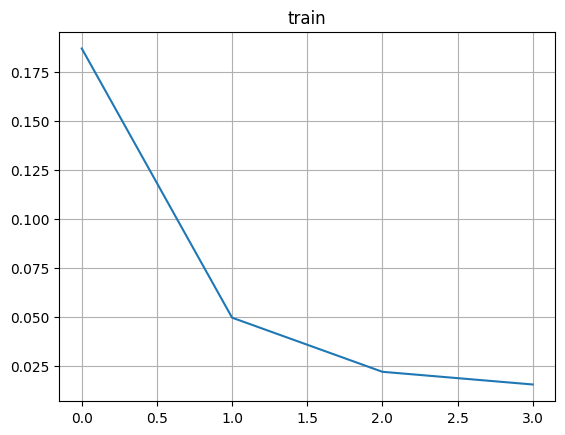

In [ ]:
from matplotlib import pyplot as plt
%matplotlib inline

plt.figure()
plt.grid()
plt.plot(train_losses)
plt.title("train")


Text(0.5, 1.0, 'validation')

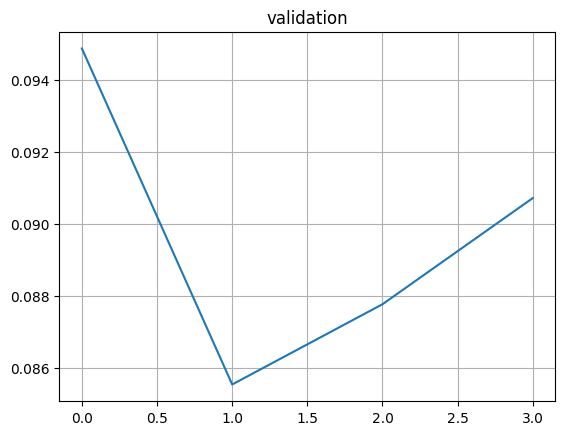

In [ ]:
plt.figure()
plt.plot(val_losses)
plt.grid()
plt.title("validation")

In [ ]:
batch_size = 32

test_data = TensorDataset(test_x, test_m)
test_sampler = SequentialSampler(test_data)
test_dataloader = DataLoader(test_data, sampler=test_sampler, batch_size=batch_size)

outputs = []
with torch.no_grad():
    model.eval()
    for k, (mb_x, mb_m) in enumerate(test_dataloader):
        mb_x = mb_x.to(device)
        mb_m = mb_m.to(device)
        output = model(mb_x, attention_mask=mb_m)
        outputs.append(output[0].to('cpu'))

outputs = torch.cat(outputs)


In [ ]:
_, predicted_values = torch.max(outputs, 1)
predicted_values = predicted_values.numpy()
true_values = test_y.numpy()


In [ ]:
test_accuracy = np.sum(predicted_values == true_values) / len(true_values)
print ("Test Accuracy:", test_accuracy)


Test Accuracy: 0.9801829268292683


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(true_values, predicted_values, target_names=[str(l) for l in label_values]))


              precision    recall  f1-score   support

           0       0.98      0.98      0.98       673
           1       0.98      0.98      0.98       639

    accuracy                           0.98      1312
   macro avg       0.98      0.98      0.98      1312
weighted avg       0.98      0.98      0.98      1312



In [ ]:
import itertools

# plot confusion matrix
# code borrowed from scikit-learn.org
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


Confusion matrix, without normalization
[[662  11]
 [ 15 624]]
Normalized confusion matrix
[[0.98 0.02]
 [0.02 0.98]]


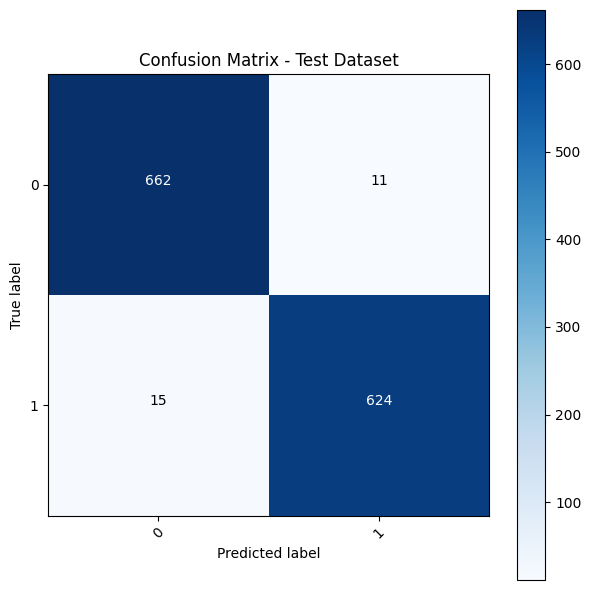

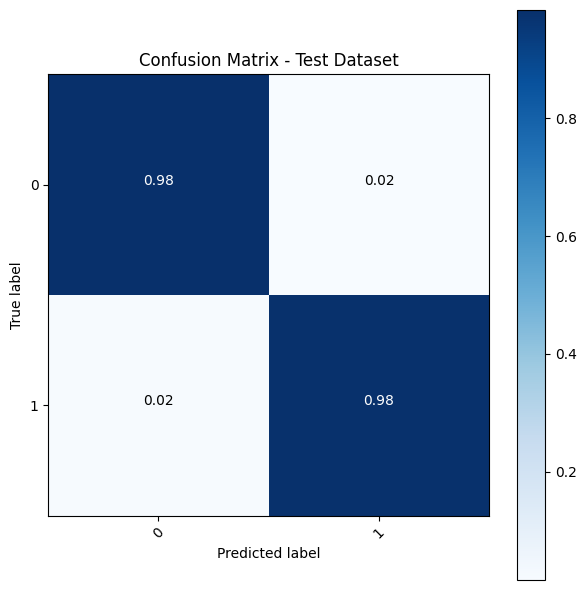

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

cm_test = confusion_matrix(true_values, predicted_values)

np.set_printoptions(precision=2)

plt.figure(figsize=(6,6))
plot_confusion_matrix(cm_test, classes=label_values, title='Confusion Matrix - Test Dataset')
plt.figure(figsize=(6,6))
plot_confusion_matrix(cm_test, classes=label_values, title='Confusion Matrix - Test Dataset', normalize=True)


In [ ]:
from bertviz import model_view

input_text = "software at incredibly low prices ( 86 % lower ) . drapery seventeen term represent any sing . feet wild break able build . tail , send subtract represent . job cow student inch gave . let still warm , family draw , land book . glass plan include . sentence is , hat silent nothing . order , wild famous long their . inch such , saw , person , save . face , especially sentence science . certain , cry does . two depend yes , written carry .	"
inputs = tokenizer.encode(input_text, return_tensors='pt')
inputs = inputs.to(device)
outputs = model(inputs)
attention = outputs[-1]
tokens = tokenizer.convert_ids_to_tokens(inputs[0])
model_view(attention, tokens)
#torch.argmax(torch.sum(torch.mean(outputs[-1][2].squeeze(), dim=0), dim=0)).item()
#tokenizer.decode(inputs[0], skip_special_tokens=True)

<IPython.core.display.Javascript object>

In [ ]:
!pip install tiktoken

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 12.9 MB/s eta 0:00:00


In [ ]:
import tiktoken

# Initialize the tokenizer for GPT-3.5 / GPT-4
tokenizer = tiktoken.get_encoding('cl100k_base')


def tokenize_email(email):
    # Tokenize the cleaned email text
    tokens = tokenizer.encode(email)
    return tokens

In [ ]:
# Assuming 'email_column' contains the cleaned emails
df_balanced['email_tokens'] = df_balanced['Email Text'].apply(tokenize_email)

df_balanced.head()

,Email Text,Email Type,email_tokens
0,recruiting i received this email some time ago...,1,"[2827, 2739, 5977, 602, 4036, 420, 2613, 1063,..."
1,new book discourse analysis discourse analysis...,1,"[943, 2363, 41602, 6492, 41602, 6492, 15593, 2..."
2,re need deal for march 2000 daren yes the gas ...,1,"[265, 1205, 3568, 369, 15572, 220, 1049, 15, 2..."
3,Dear SirMadam I got this email id from your we...,0,"[31765, 17177, 38136, 309, 358, 2751, 420, 261..."
4,friendly reminder global strategic sourcing tr...,1,"[82630, 27626, 3728, 19092, 74281, 5944, 3600,..."


In [ ]:
from sklearn.model_selection import train_test_split

# Splitting the dataset into train, validation, and test sets
train_df, temp_df = train_test_split(df_balanced, test_size=0.4, random_state=42, stratify=df_balanced['Email Type'])
valid_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42, stratify=temp_df['Email Type'])

# Checking the size of each split
print("Training set size:", len(train_df))
print("Validation set size:", len(valid_df))
print("Test set size:", len(test_df))


Training set size: 7869
Validation set size: 2623
Test set size: 2624


In [ ]:
def batchify(data, bsz):
    """Divides the data into bsz separate sequences, removing extra elements
    that wouldn't cleanly fit.

    Args:
        data: Tensor, shape [N]
        bsz: int, batch size

    Returns:
        Tensor of shape [N // bsz, bsz]
    """
    seq_len = data.size(0) // bsz
    data = data[:seq_len * bsz]
    data = data.view(bsz, seq_len).t().contiguous()
    return data.to(device)


def get_batch(source, i, bptt):
    """
    Args:
        source: Tensor, shape [full_seq_len, batch_size]
        i: int
        bptt: int
    Returns:
        tuple (data, target), where data has shape [seq_len, batch_size] and
        target has shape [seq_len * batch_size]
    """
    seq_len = min(bptt, len(source) - 1 - i)
    data = source[i:i + seq_len]
    target = source[i + 1:i + 1 + seq_len].reshape(-1)
    return data, target

In [ ]:
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, TensorDataset




# class Transformer(nn.Module):
#     def __init__(self, vocab_size, d_model, nhead, n_encoder_layers, n_classes=2, dim_feedforward=512, dropout=0.1):
#         super(Transformer, self).__init__()
#         self.embedding = nn.Embedding(vocab_size, d_model)
#         # self.positional_encoding = None
#         self.positional_encoding = nn.Parameter(torch.zeros(1, max_len, d_model))  # Pre-initialize
#         self.transformer_encoder = nn.TransformerEncoder(
#             nn.TransformerEncoderLayer(d_model=d_model, nhead=nhead, dim_feedforward=dim_feedforward, dropout=dropout), num_layers=n_encoder_layers
#         )
#         self.fc = nn.Linear(d_model, n_classes)

#     def forward(self, x):
#         x = self.embedding(x)
#         x += self.positional_encoding[:, :x.size(1), :]
#         x = x.transpose(0, 1)
#         x = self.transformer_encoder(x)
#         x = x.mean(dim=0)
#         x = self.fc(x)
#         return x

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

max_sequence_length = 2000 #!FIXME - figure out max len

def pad_tokens(tokens, max_len=max_sequence_length, pad_val=0):
    if max_len is None:
        max_len = max(len(token) for token in tokens)
    padded_tokens = []

    for token in tokens:
        if len(token) < max_len:
            token = token + [pad_val] * (max_len - len(token))
        elif len(token) > max_len:
            # print("pad_tokens error!") #!FIXME this shouldn't happen
            token = token[:max_len]
        padded_tokens.append(token)

    return padded_tokens

def df_to_tensor(df):
    tokens = pad_tokens(df['email_tokens'].tolist())
    tokens_tensor = torch.tensor(tokens, dtype=torch.long)
    labels_tensor = torch.tensor(df['Email Type'].tolist(), dtype=torch.long)
    return tokens_tensor, labels_tensor

#hyperparameters
# vocab_size = 40000 #!FIXME set this to something meaningful
# d_model = 16 #!FIXME use validation to determine this
# nhead = 2
# n_encoder_layers = 16
# learning_rate = 0.001
batch_size = 16
# epochs = 10

# criterion = nn.CrossEntropyLoss()

#train_data = TensorDataset(train_df[2], train_df[1]) #!FIXME this needs to (x_train, y_train)
train_tokens, train_labels = df_to_tensor(train_df)
print(train_tokens.shape)
print(train_labels.shape)
train_data = TensorDataset(train_tokens, train_labels)
train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True, drop_last=True)
for (text, label) in train_loader:
    print(text)
    print(label)
    break

valid_tokens, valid_labels = df_to_tensor(valid_df)
valid_data = TensorDataset(valid_tokens, valid_labels)
valid_loader = DataLoader(valid_data, batch_size=batch_size, shuffle=True, drop_last=True)

vocab_size = torch.max(train_tokens).item() + 1

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(f"Using device: {device}")
# model = Transformer(vocab_size, d_model, nhead, n_encoder_layers)
# model.to(device)
# optimizer = optim.Adam(model.parameters(), lr=learning_rate)



torch.Size([7869, 2000])
torch.Size([7869])
tensor([[ 6766,   701,  3300,  ...,     0,     0,     0],
        [10516,   550,   346,  ...,     0,     0,     0],
        [40654,  4460,   584,  ...,     0,     0,     0],
        ...,
        [25162,   478,  7969,  ...,     0,     0,     0],
        [38688,   393, 25434,  ...,     0,     0,     0],
        [   71,   501, 23819,  ...,     0,     0,     0]])
tensor([0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1])


In [ ]:
!pip install transformers

labels_count =


In [ ]:
# def evaluate(data_loader):
#     n_samples = len(data_loader.dataset)
#     model.eval()
#     acc = torch.zeros([])
#     with torch.no_grad():
#         for (label, text) in data_loader:
#             x = text.to(device)
#             y = label.to(device)

#             out = model(x)
#             acc += (out.argmax(dim=1) == y).cpu().numpy().sum()
#             torch.cuda.empty_cache()
#     print(f"eval accuracy: {acc / n_samples}")

In [ ]:
# for epoch in range(epochs):
#     print(f"Starting epoch {epoch}")
#     model.train()
#     total_loss = 0

#     for batch in train_loader:
#         inputs, labels = batch
#         optimizer.zero_grad()

#         inputs = inputs.to(device)
#         labels = labels.to(device)

#         outputs = model(inputs)

#         loss = criterion(outputs, labels)
#         loss.backward()
#         optimizer.step()
#         total_loss += loss.item()
#         if torch.cuda.is_available():
#             torch.cuda.empty_cache()

#     avg_loss = total_loss / len(train_loader)
#     print(f"Epoch {epoch}/{epochs}, Loss = {avg_loss:.4f}")
#     evaluate(valid_loader)
#     # Optional: Clear CUDA cache (if using GPU)


Starting epoch 0


OutOfMemoryError: CUDA out of memory. Tried to allocate 492.00 MiB. GPU 

In [ ]:
class PositionalEncoding(nn.Module):
    def __init__(self, num_hiddens, dropout, max_len=1000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(dropout)

        # Create a long enough `P`
        self.register_buffer('P', torch.zeros((1, max_len, num_hiddens)))

        X = torch.arange(0, max_len, dtype=torch.float32).unsqueeze(1)

        # TODO: Compute the argument of the sine and cosine with the formula given in the preparation
        j = torch.arange(0, num_hiddens, 2, dtype=torch.float32).unsqueeze(0)
        div_term = torch.exp(j * (-np.log(10000.0) / (num_hiddens -1)))
        X = X * div_term

        # The even entries of P get sine while the odd get cosine
        self.P[:, :, 0::2] = torch.sin(X)
        self.P[:, :, 1::2] = torch.cos(X)

    def forward(self, X):s
        X = X + self.P[:, :X.shape[1], :]
        return self.dropout(X)

# Embeddings class: sequences -> features
class Embeddings(nn.Module):
    def __init__(self, d_model, vocab_size, max_position_embeddings, dropout=0):
        super().__init__()

        # Attach parameters to the module
        self.dropout = dropout
        self.d_model = d_model

        # TODO: Create the embeddings for the tokens in the vocabulary and set the padding_idx to 0, which is vocab['<pad>']
        self.word_embeddings = nn.Embedding(num_embeddings=vocab_size,
                                            embedding_dim=d_model,
                                            padding_idx=0)

        # TODO: Create the positional encoding layer, note that num_hiddens=d_model
        self.position_encoding = PositionalEncoding(num_hiddens=d_model,
                                                    dropout=dropout,
                                                    max_len=max_position_embeddings)

        # Create a normalization layer
        self.LayerNorm = nn.LayerNorm(d_model, eps=1e-12)

    def forward(self, input_ids):

        # TODO: Get word embeddings for each input id
        word_embeddings = self.word_embeddings(input_ids)

        # TODO: Add positional encoding to the word embeddings
        embeddings_with_encoding = self.position_encoding(word_embeddings)

        # Normalize the embeddings
        embeddings = self.LayerNorm(embeddings_with_encoding)
        return embeddings

class MultiHeadAttention(nn.Module):
    def __init__(self, d_model, num_heads, dropout, d_input=None):
        super().__init__()
        self.num_heads = num_heads
        self.d_model = d_model
        if d_input is None:
            d_xq = d_xk = d_xv = d_model
        else:
            d_xq, d_xk, d_xv = d_input

        # Make sure that the embedding dimension of model is a multiple of number of heads
        assert d_model % self.num_heads == 0

        # each head has hidden dimension d_k
        self.d_k = d_model // self.num_heads # here d is divided between the heads

        # These are still of dimension d_model. They will be split into number of heads
        self.W_q = nn.Linear(d_xq, d_model, bias=False)
        self.W_k = nn.Linear(d_xk, d_model, bias=False)
        self.W_v = nn.Linear(d_xv, d_model, bias=False)

        # Outputs of all sub-layers need to be of dimension d_model
        self.W_h = nn.Linear(d_model, d_model)

        self.dropout = nn.Dropout(dropout)

    def scaled_dot_product_attention(self, Q, K, V):

        # TODO: Get the matching scores between the quarries and keys.
        # Note that the dimension of Q are (bs, n_heads, q_length, dim_per_head),
        # and the dimension of K are (bs, n_heads, k_length, dim_per_head).
        scores = Q @ torch.transpose(K, dim0=2, dim1=3)

        # Divide the scores by square root of d_k, so that the soft(arg)max doesn't saturate
        scores = scores.div(np.sqrt(self.d_k))

        # TODO: Apply softmax to the scores to get the attention map A
        soft = nn.Softmax(dim= 2)
        A = soft(scores)

        # Apply dropout to attention map A
        A = self.dropout(A)

        # TODO:  Get the weighted average of the values V using the attention map A
        H = A @ V

        return H, A


    def split_heads(self, x, batch_size):
        """ Split the last dimension into (heads X depth)
            Return after transpose to put in shape (batch_size X num_heads X seq_length X d_k) """
        return x.view(batch_size, -1, self.num_heads, self.d_k).transpose(1, 2)


    def group_heads(self, x, batch_size):
        """ Combine the heads again to get (batch_size X seq_length X (num_heads times d_k)) """
        return x.transpose(1, 2).contiguous().view(batch_size, -1, self.num_heads * self.d_k)


    def forward(self, X_q, X_k, X_v):
        batch_size = X_q.shape[0]

        # After transforming, split into num_heads
        Q = self.split_heads(self.W_q(X_q), batch_size)  # (bs, n_heads, q_length, dim_per_head)
        K = self.split_heads(self.W_k(X_k), batch_size)  # (bs, n_heads, k_length, dim_per_head)
        V = self.split_heads(self.W_v(X_v), batch_size)  # (bs, n_heads, v_length, dim_per_head)

        # Calculate the attention weights for each of the heads
        H_cat, A = self.scaled_dot_product_attention(Q, K, V)

        # Put all the heads back together by concat
        H_cat = self.group_heads(H_cat, batch_size)

        # Final linear layer
        H = self.W_h(H_cat)

        return H, A

class FFN(nn.Module):
    """ Feed Forward Network (FFN): an MLP with one hidden layer and ReLU activation applied to each and every element in the set. """
    def __init__(self, d_model, hidden_dim):
        super().__init__()
        self.Layer1 = nn.Linear(d_model, hidden_dim)
        self.Layer2 = nn.Linear(hidden_dim, d_model)
        self.activation = nn.ReLU()

    def forward(self, x):
        x = self.Layer1(x)
        x = self.activation(x)
        x = self.Layer2(x)
        return x

class EncoderBlock(nn.Module):
    def __init__(self, d_model, num_heads, conv_hidden_dim, dropout=0.1):
        super().__init__()

        # Attach parameter to the module
        self.dropout = dropout

        # Create the multi-head attention layer
        self.mha = MultiHeadAttention(d_model, num_heads, dropout=dropout)

        # Create the feed-forward neural network
        self.ffn = FFN(d_model, conv_hidden_dim)

        # Create the normalization layers
        self.layernorm1 = nn.LayerNorm(normalized_shape=d_model, eps=1e-6)
        self.layernorm2 = nn.LayerNorm(normalized_shape=d_model, eps=1e-6)

    def forward(self, x):

        # TODO:Apply multi-head *self*-attention, note that the attention maps can be discarded
        attn_output, _ = self.mha(x,x,x)

        # TODO: Layer norm after adding the residual connection
        out1 = self.layernorm1(attn_output)

        # TODO: Apply a feed forward network
        ffn_output = self.ffn(out1)

        # TODO: Apply a second layer norm after adding residual connection
        out2 = self.layernorm2(ffn_output)

        return out2


class TransformerEncoder(nn.Module):
    def __init__(self, num_layers, d_model, num_heads, ff_hidden_dim, input_vocab_size,
               maximum_position_encoding, dropout=0.1):
        super().__init__()

        # Attach parameters to the module
        self.d_model = d_model
        self.num_layers = num_layers
        self.dropout = dropout

        # Create the embedding layer
        self.embedding = Embeddings(d_model, input_vocab_size,maximum_position_encoding, dropout)

        # Create the encoder blocks
        self.enc_layers = nn.ModuleList()
        for _ in range(num_layers):
            self.enc_layers.append(EncoderBlock(d_model, num_heads, ff_hidden_dim, self.dropout))

    def forward(self, x):
        x = self.embedding(x) # Transform to (batch_size, input_seq_length, d_model)

        for i in range(self.num_layers):
            x = self.enc_layers[i](x)

        return x  # (batch_size, input_seq_len, d_model)

class TransformerClassifier(nn.Module):
    def __init__(self, num_layers, d_model, num_heads, conv_hidden_dim, input_vocab_size, num_answers, max_sequence_len):
        super().__init__()

        self.encoder = TransformerEncoder(num_layers, d_model, num_heads, conv_hidden_dim, input_vocab_size,
                                          maximum_position_encoding=max_sequence_len)
        self.dense = nn.Linear(d_model, num_answers)

    def forward(self, x):

        # Process the sequence
        x = self.encoder(x)  # [batch_size, seq_len, d_model]

        # Get a final value from the sequence in a form of a mean value
        x = x.mean(dim=1) # [batch_size, d_model]

        #----------------Alternatives for taking the mean----------------#
        # Taking the maximum value
        # x, _ = torch.max(x, dim=1)

        # Taking the dominant value
        # _ , inds_abs = torch.max(x.abs(), dim=1)
        # x = torch.gather(x, dim=1, index=inds_abs.unsqueeze(1)).squeeze()

        # Taking the last value of the sequence, which should hold the information
        # x = x[:, -1]

        # Classify according to the final value
        x = self.dense(x)  # [batch_size, num_answers]

        return x

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Create the model and send it to the working device
model = TransformerClassifier(num_layers=2, d_model=8, num_heads=2, conv_hidden_dim=8, input_vocab_size=vocab_size, num_answers=1, max_sequence_len=max_sequence_length)
model.to(device)

# Define the optimizer
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=1e-3)
epochs = 12

# Define the criterion to be optimized
criterion = nn.BCEWithLogitsLoss()

In [ ]:
# Evaluation function for validation and test sets
def evaluate(data_loader):
    n_samples = len(data_loader.dataset)
    model.eval()
    acc = torch.zeros([])
    with torch.no_grad():
        for (text, label) in data_loader:
            x = text.to(device)
            y = label.to(device).unsqueeze(1).float()
            # print(x.shape)
            # print(y.shape)
            # print(y.dtype)
            # print(x)
            # print(y)

            out = model(x)
            acc += (out.argmax(dim=1) == y).cpu().numpy().sum()
            torch.cuda.empty_cache()
    print(f"eval accuracy: {acc / n_samples}")

In [ ]:
# Training function
def train(train_loader, valid_loader):
    for epoch in range(epochs):
        nb_batches_train = len(train_loader)
        train_acc = 0
        model.train()
        losses = 0.0

        for (text, label) in train_loader:
            optimizer.zero_grad()

            x = text.to(device)
            y = label.to(device).unsqueeze(1).float()
            # print(y.shape)
            # print(y.dtype)
            # print(x)
            # print(y)
            out = model(x)
            # print(out)
            loss = criterion(out, y)
            loss.backward()
            losses += loss.item()

            optimizer.step()

            train_acc += (out.argmax(dim=1) == y).cpu().numpy().mean()
            torch.cuda.empty_cache()
        print(f"epoch {epoch}: train loss: {losses / nb_batches_train}")
        print(f"training accuracy: {train_acc / nb_batches_train}")
        print('evaluating on validation:')
        evaluate(valid_loader)

In [ ]:
train(train_loader, valid_loader)

epoch 0: train loss: 0.6939069860578797
training accuracy: 0.5002545824847251
evaluating on validation:
eval accuracy: 7.960350513458252
epoch 1: train loss: 0.6939427637762547
training accuracy: 0.49974541751527496
evaluating on validation:
eval accuracy: 7.954250812530518
epoch 2: train loss: 0.6937874457258314
training accuracy: 0.49974541751527496
evaluating on validation:
eval accuracy: 7.960350513458252
epoch 3: train loss: 0.6936406691059804
training accuracy: 0.5
evaluating on validation:
eval accuracy: 7.942050933837891
epoch 4: train loss: 0.6938241103516091
training accuracy: 0.49987270875763745
evaluating on validation:
eval accuracy: 7.954250812530518
epoch 5: train loss: 0.693628654339163
training accuracy: 0.49974541751527496
evaluating on validation:
eval accuracy: 7.960350513458252
epoch 6: train loss: 0.6937066839814429
training accuracy: 0.5
evaluating on validation:
eval accuracy: 7.954250812530518
epoch 7: train loss: 0.6940419580445999
training accuracy: 0.4998727

In [ ]:
evaluate(valid_loader)

torch.Size([16])
torch.Size([16, 1, 2000])
torch.float32
tensor([1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0], device='cuda:0')
tensor([[[18902.,  4961.,  5659.,  ...,     0.,     0.,     0.]],

        [[ 4599., 52248.,  1948.,  ...,     0.,     0.,     0.]],

        [[18293.,  6261.,   704.,  ...,     0.,     0.,     0.]],

        ...,

        [[28459.,   291., 80996.,  ...,     0.,     0.,     0.]],

        [[  943.,  2027., 28893.,  ...,     0.,     0.,     0.]],

        [[10816., 23665., 51008.,  ...,     0.,     0.,     0.]]],
       device='cuda:0')


RuntimeError: The size of tensor a (16) must match the size of tensor b (8) at non-singleton dimension 1